<a href="https://colab.research.google.com/github/medbouzid/INSE6220/blob/main/Dry_Bean_Classification_with_Pycaret.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Multiclass Classification with PyCaret**

Multiclass classification is a supervised machine learning technique where the goal is to classify instances into one of three or more classes. (Classifying instances into one of two classes is called Binary Classification).

**Install Pycaret**

In [ ]:
# install slim version (default): if you get an error message, run it again
!pip install pycaret

**Import Libraries**

In [121]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="darkgrid")
import pandas as pd
plt.rcParams['figure.figsize'] = (7,5)

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler,LabelEncoder

In [122]:
print("Pandas version: ", pd.__version__)
print("Seaborn version: ", sns.__version__)

Pandas version:  1.3.5
Seaborn version:  0.11.2


# **Dataset** 
#### - The dataset consists of features describing the shape of the bean and the goal is to predict it's type.
#### - This dataset is collected using a computer vision system that extracted shape features from beans images.

#### **Data fields:**
1. **Area - (A)**, The area of a bean zone and the number of pixels within its boundaries.
2. **Perimeter - (P)**, Bean circumference is defined as the length of its border.
3. **MajorAxisLength - (L)**, The distance between the ends of the longest line that can be drawn from a bean.
4. **MinorAxisLength - (l)**, The longest line that can be drawn from the bean while standing perpendicular to the main axis.
5. **AspectRatio - (K)**, Defines the relationship between L and l : \\(K = \frac{L}{l}\\)
6. **Eccentricity - (Ec)**, Eccentricity of the ellipse having the same moments as the region.
7. **ConvexArea - (C)**, Number of pixels in the smallest convex polygon that can contain the area of a bean seed.
8. **EquivDiameter - (Ed)**, The diameter of a circle having the same area as a bean seed area: \\(E_{d} = \sqrt{\frac{4A}{\pi}}\\)
9. **Extent - (Ex)**, The ratio of the pixels in the bounding box to the bean area \\(Ex = \frac{A}{A_{B}}\\) Where \\(A_{B} = \\) Area of bounding rectangle.
10. **Solidity - (S)**, Also known as convexity. The ratio of the pixels in the convex shell to those found in beans: \\(S = \frac{A}{C}\\)
11. **Roundness - (R)**, Calculated with the following formula: \\(R = \frac{4\pi A}{P^2}\\)
12. **Compactness - (CO)**, Measures the roundness of an object: \\(CO = \frac{E_{d}}{L}\\)
13. **ShapeFactor1** - \\((SF_{1})\\) Calculated with the following formula: \\(SF_{1} = \frac{L}{A}\\)
14. **ShapeFactor2** - \\((SF_{2})\\) Calculated with the following formula: \\(SF_{2} = \frac{l}{A}\\)
15. **ShapeFactor3** - \\((SF_{3})\\) Calculated with the following formula: \\(SF_{3} = \frac{A}{\frac{L}{2}*\frac{L}{2}*\pi}\\)
16. **ShapeFactor4** - \\((SF_{4})\\) Calculated with the following formula: \\(SF_{4} = \frac{A}{\frac{L}{2}*\frac{l}{2}*\pi}\\)
17. **y**, the class of the bean. It can be any of ***BARBUNYA*, *SIRA*, *HOROZ*, *DERMASON*, *CALI*, *BOMBAY*, and *SEKER***.

#### **The general features of the specified dry beans are as follows:**
> - **Cali;** It is white in color, its seeds are slightly plump and slightly larger than dry beans and in shape of kidney.
> - **Horoz;** Dry beans of this type are long, cylindrical, white in color and generally medium in size.
> - **Dermason;** This type of dry beans, which are fuller flat, is white in color and one end is round and the other ends are round.
> - **Seker;** Large seeds, white in color, physical shape is round.
> - **Bombay;** It is white in color, its seeds are very big and its physical structure is oval and bulging.
> - **Barbunya;** Beige-colored background with red stripes or variegated, speckled color, its seeds are large, physical shape is oval close to the round.
> - **Sira;** Its seeds are small, white in color, physical structure is flat, one end is flat, and the other end is round.

Source : https://archive.ics.uci.edu/ml/datasets/Dry+Bean+Dataset

<center><img src="https://i.ibb.co/9hb9jKh/Capture.jpg" width=600 height=600/></center>

In [216]:
#read cvs file into dataframe
df = pd.read_csv('https://raw.githubusercontent.com/medbouzid/INSE6220/main/Dry_Bean_Dataset.csv')
df.head(5)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,SEKER
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272751,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,SEKER
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066,SEKER
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199,SEKER
4,30140,620.134,201.847882,190.279279,1.060798,0.333680,30417,195.896503,0.773098,0.990893,0.984877,0.970516,0.006697,0.003665,0.941900,0.999166,SEKER


In [217]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13611 entries, 0 to 13610
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             13611 non-null  int64  
 1   Perimeter        13611 non-null  float64
 2   MajorAxisLength  13611 non-null  float64
 3   MinorAxisLength  13611 non-null  float64
 4   AspectRation     13611 non-null  float64
 5   Eccentricity     13611 non-null  float64
 6   ConvexArea       13611 non-null  int64  
 7   EquivDiameter    13611 non-null  float64
 8   Extent           13611 non-null  float64
 9   Solidity         13611 non-null  float64
 10  roundness        13611 non-null  float64
 11  Compactness      13611 non-null  float64
 12  ShapeFactor1     13611 non-null  float64
 13  ShapeFactor2     13611 non-null  float64
 14  ShapeFactor3     13611 non-null  float64
 15  ShapeFactor4     13611 non-null  float64
 16  Class            13611 non-null  object 
dtypes: float64(1

In [218]:
## Assigning numerical values to categorical classes
labelencoder = LabelEncoder()
df['Class'] = labelencoder.fit_transform(df['Class'])

In [219]:
print("Number of duplicated rows is: ", df.duplicated().sum())

Number of duplicated rows is:  68


In [220]:
# there are 68 duplicates, we need to drop them
df.drop_duplicates(inplace=True)

In [221]:
print("Number of rows with NaNs is: ", df.isna().any(axis=1).sum())

Number of rows with NaNs is:  0


**Exploratory Data Analysis**

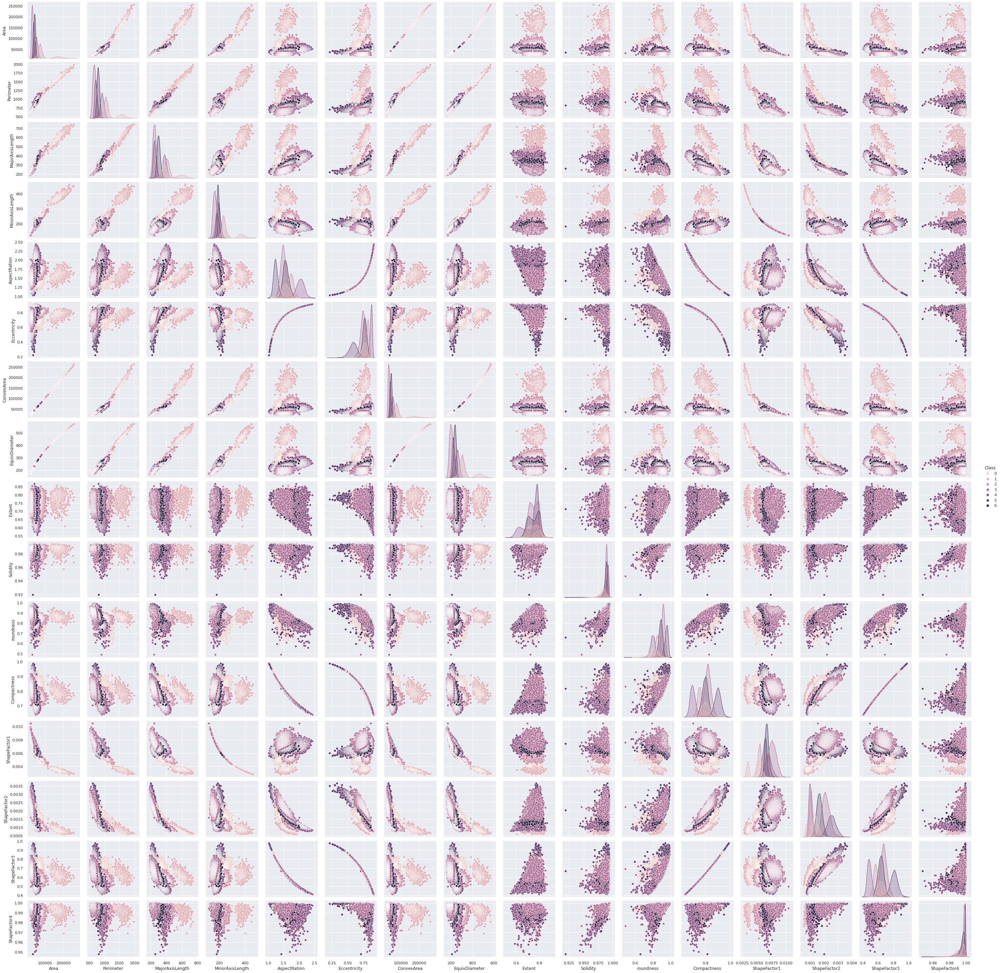

In [129]:
sns.set(rc = {'figure.figsize':(10,10)})
sns.pairplot(df, hue='Class')
plt.show()

In [222]:
# drop a subset of outliers for better illustration purposes
from scipy import stats
df=df[(np.abs(stats.zscore(df)) < 4).all(axis=1)]

In [223]:
print('Number of of samples in the dataset after removing some outliers: %d' % len(df))

Number of of samples in the dataset after removing some outliers: 13069


In [224]:
df.reset_index(drop=True,inplace=True)

In [225]:
df1=df.copy()
df1['Class']= labelencoder.inverse_transform(df1['Class'])

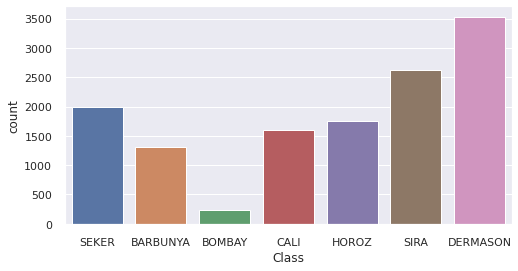

In [226]:
plt.figure(figsize=(8, 4))
sns.countplot(x='Class', data=df1);

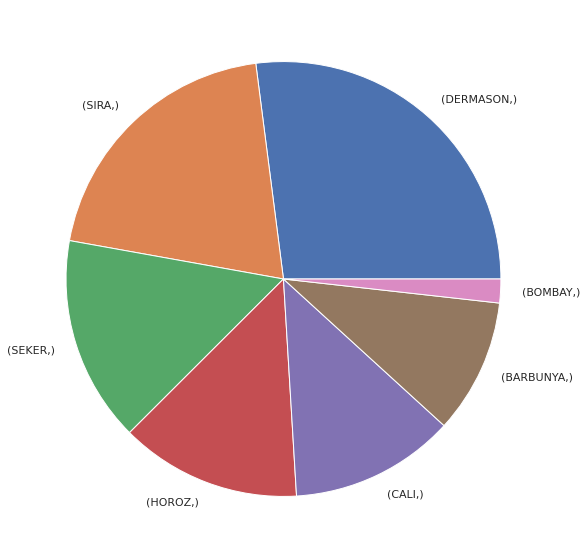

In [227]:
y =df['Class']
y_cat=pd.DataFrame(labelencoder.inverse_transform(y))
y_cat.value_counts().plot(kind='pie')
plt.ylabel('')
plt.show()

**Data Matrix**

In [228]:
X = df.drop(columns=['Class'])
X.head(10)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272751,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199
4,30279,634.927,212.560556,181.510182,1.171067,0.520401,30600,196.347702,0.775688,0.989510,0.943852,0.923726,0.007020,0.003153,0.853270,0.999236
5,30477,670.033,211.050155,184.039050,1.146768,0.489478,30970,196.988633,0.762402,0.984081,0.853080,0.933374,0.006925,0.003242,0.871186,0.999049
6,30519,629.727,212.996755,182.737204,1.165591,0.513760,30847,197.124320,0.770682,0.989367,0.967109,0.925480,0.006979,0.003158,0.856514,0.998345
7,30685,635.681,213.534145,183.157146,1.165852,0.514081,31044,197.659696,0.771561,0.988436,0.954240,0.925658,0.006959,0.003152,0.856844,0.998953
8,30834,631.934,217.227813,180.897469,1.200834,0.553642,31120,198.139012,0.783683,0.990810,0.970278,0.912125,0.007045,0.003008,0.831973,0.999061
9,30917,640.765,213.560089,184.439871,1.157885,0.504102,31280,198.405511,0.770805,0.988395,0.946258,0.929038,0.006908,0.003174,0.863112,0.999384


In [229]:
X.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Area,13069.0,49997.770679,21528.170521,20420.000000,36069.000000,44005.000000,59468.000000,170598.000000
Perimeter,13069.0,835.934967,179.915624,524.736000,700.460000,787.214000,961.806000,1620.307000
MajorAxisLength,13069.0,312.724387,73.403622,183.601165,252.136479,293.441256,371.718651,633.005349
MinorAxisLength,13069.0,198.216175,36.024704,122.512653,175.242782,191.745199,213.958916,381.837178
AspectRation,13069.0,1.578458,0.245650,1.083007,1.427833,1.546435,1.699983,2.430306
Eccentricity,13069.0,0.749475,0.091082,0.383947,0.713788,0.762788,0.808686,0.911423
ConvexArea,13069.0,50658.677405,21870.924770,20684.000000,36461.000000,44560.000000,60289.000000,172462.000000
EquivDiameter,13069.0,247.641856,48.299361,161.243764,214.299970,236.704259,275.167239,466.060210
Extent,13069.0,0.749552,0.048743,0.555315,0.718641,0.759424,0.786429,0.866195
Solidity,13069.0,0.987434,0.003880,0.968875,0.985864,0.988341,0.990035,0.994677


**Standardize the Data**

In [230]:
Xs = StandardScaler().fit_transform(X)
Xcols = X.columns
X = pd.DataFrame(Xs)
X.columns = Xcols
X.head(10)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
0,-1.003504,-1.254213,-1.424320,-0.675324,-1.552135,-2.192215,-1.003365,-1.190553,0.294834,0.366474,1.420481,1.828039,0.673764,2.413672,1.915643,0.930557
1,-0.987756,-1.100096,-1.528588,-0.429770,-1.958563,-3.707695,-0.982469,-1.167122,0.706104,-0.630967,0.201988,2.487914,0.332899,3.129470,2.683774,0.848476
2,-0.957748,-1.177402,-1.360997,-0.618628,-1.501161,-2.050412,-0.958783,-1.122852,0.585981,0.547586,1.245797,1.753365,0.589145,2.242507,1.830817,1.026251
3,-0.928576,-1.056374,-1.391897,-0.435819,-1.729441,-2.754329,-0.911504,-1.080279,0.679702,-2.767350,0.492098,2.071947,0.369676,2.529334,2.195684,-0.334668
4,-0.915987,-1.117277,-1.364615,-0.463755,-1.658488,-2.515142,-0.917174,-1.062045,0.536233,0.534966,1.177183,1.996957,0.372899,2.423111,2.109100,1.073684
5,-0.906789,-0.922145,-1.385192,-0.393554,-1.757407,-2.854661,-0.900256,-1.048775,0.263627,-0.863998,-0.380775,2.154136,0.280965,2.576535,2.291073,1.021386
6,-0.904838,-1.146181,-1.358672,-0.429693,-1.680782,-2.588058,-0.905880,-1.045966,0.433512,0.498132,1.576361,2.025541,0.333376,2.432578,2.142052,0.824494
7,-0.897127,-1.113086,-1.351351,-0.418035,-1.679718,-2.584531,-0.896872,-1.034881,0.451560,0.258176,1.355477,2.028442,0.313821,2.420998,2.145400,0.994612
8,-0.890206,-1.133914,-1.301029,-0.480764,-1.537307,-2.150163,-0.893397,-1.024956,0.700250,0.869981,1.630752,1.807962,0.397059,2.174264,1.892795,1.024854
9,-0.886350,-1.084828,-1.350997,-0.382427,-1.712153,-2.694090,-0.886081,-1.019439,0.436045,0.247706,1.218485,2.083507,0.264185,2.459974,2.209068,1.115236


In [231]:
X.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Area,13069.0,4.116677e-16,1.000038,-1.373963,-0.647027,-0.278379,0.439916,5.602187
Perimeter,13069.0,-1.124282e-16,1.000038,-1.729760,-0.753020,-0.270809,0.699638,4.359833
MajorAxisLength,13069.0,-2.293780e-16,1.000038,-1.759152,-0.825439,-0.262710,0.803728,4.363452
MinorAxisLength,13069.0,-3.162509e-16,1.000038,-2.101514,-0.637737,-0.179633,0.437015,5.097281
AspectRation,13069.0,-9.058482e-16,1.000038,-2.016980,-0.613195,-0.130369,0.494728,3.467869
Eccentricity,13069.0,1.256751e-15,1.000038,-4.013351,-0.391829,0.146172,0.650111,1.778125
ConvexArea,13069.0,-9.237049e-16,1.000038,-1.370579,-0.649182,-0.278859,0.440342,5.569402
EquivDiameter,13069.0,-7.820663e-16,1.000038,-1.788872,-0.690344,-0.226463,0.569913,4.522352
Extent,13069.0,-1.633775e-16,1.000038,-3.985115,-0.634203,0.202548,0.756595,2.393123
Solidity,13069.0,2.512463e-14,1.000038,-4.782908,-0.404507,0.233647,0.670367,1.866735


**Observations and variables**

In [232]:
observations = list(df.index)
variables = list(df.columns)

**Box and Whisker Plots**

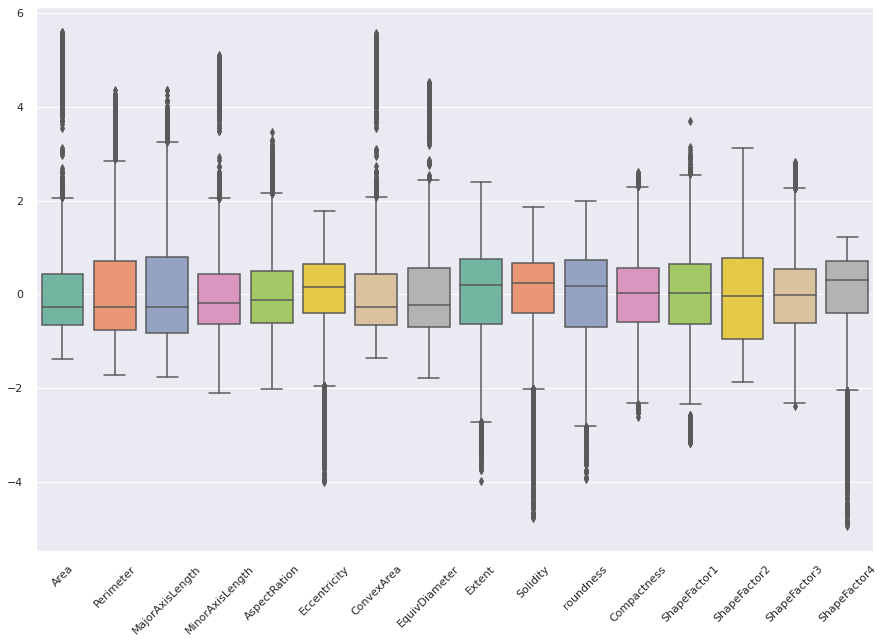

In [233]:
ax = plt.figure(figsize=(15,10))
ax = sns.boxplot(data=X, orient="v", palette="Set2")
ax.set_xticklabels(ax.get_xticklabels(),rotation=45);

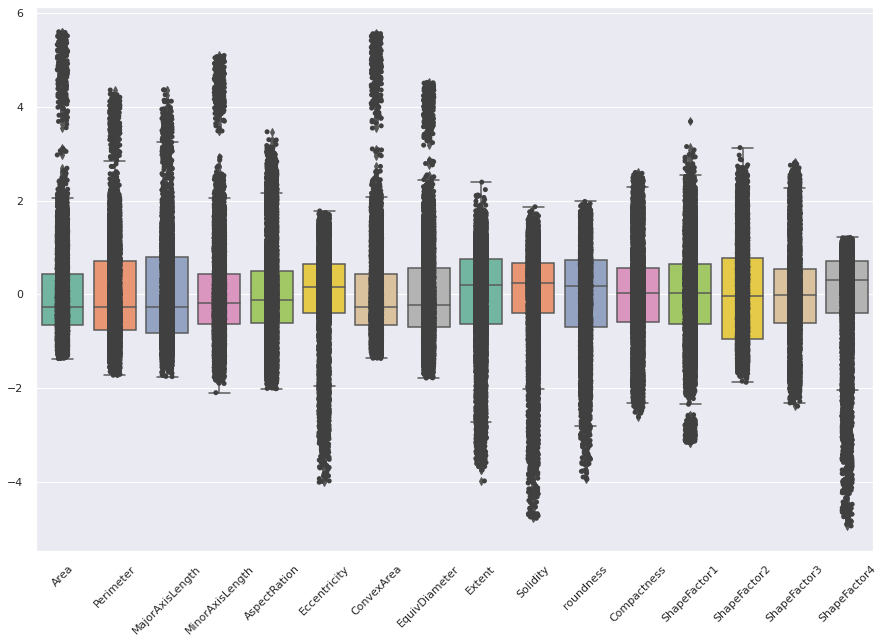

In [234]:
# Use swarmplot() or stripplot to show the datapoints on top of the boxes:
#plt. figure()
ax = plt.figure(figsize=(15,10))    
ax = sns.boxplot(data=X, orient="v", palette="Set2")
ax = sns.stripplot(data=X, color=".25") 
ax.set_xticklabels(ax.get_xticklabels(),rotation=45);

**Correlation Matrix**

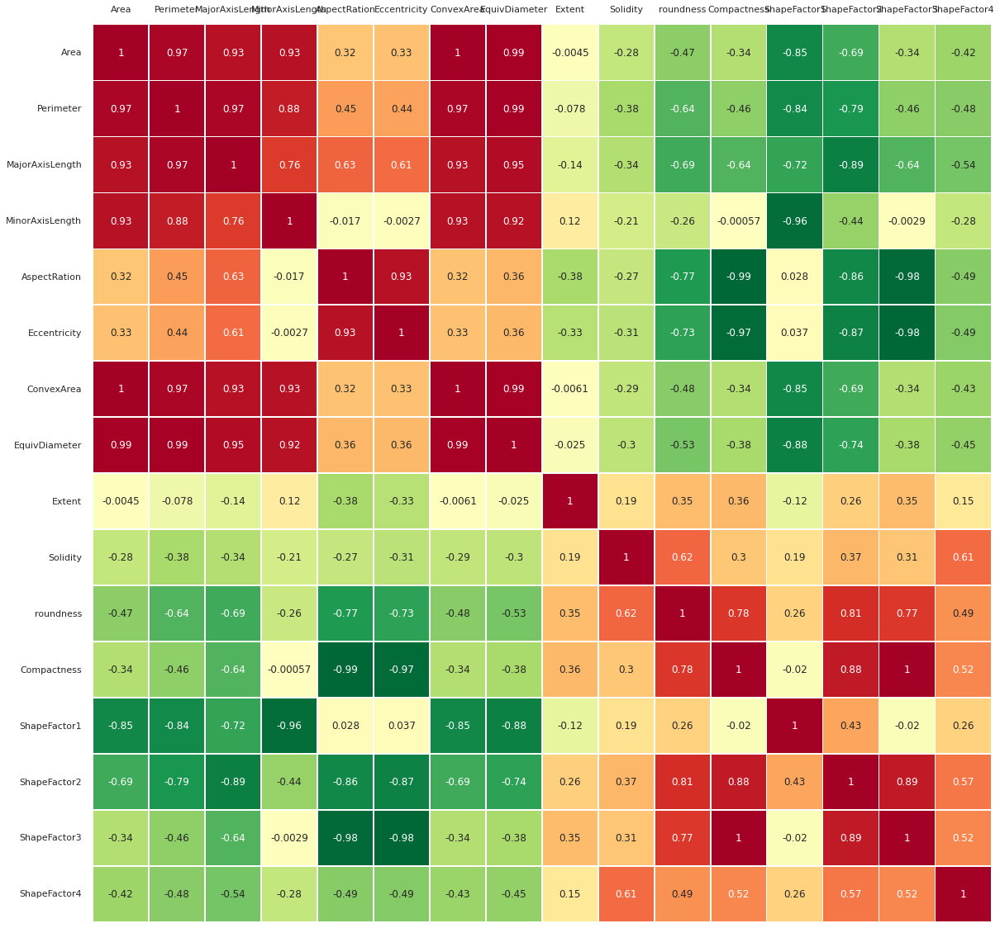

In [235]:
sns.set(rc = {'figure.figsize':(20,20)})
ax = sns.heatmap(X.corr(), cmap='RdYlGn_r', linewidths=0.8, annot=True, cbar=False, square=True)
plt.yticks(rotation=0)
ax.tick_params(labelbottom=False,labeltop=True)
ax.set_xticklabels(ax.get_xticklabels(),rotation=0);

#X.corr().style.background_gradient(cmap='coolwarm').set_precision(2)
#sns.clustermap(X.corr(), annot=True, fmt='.2f')

#**Principal Component Analysis (PCA)**

Text(0, 0.5, '$Z_2$')

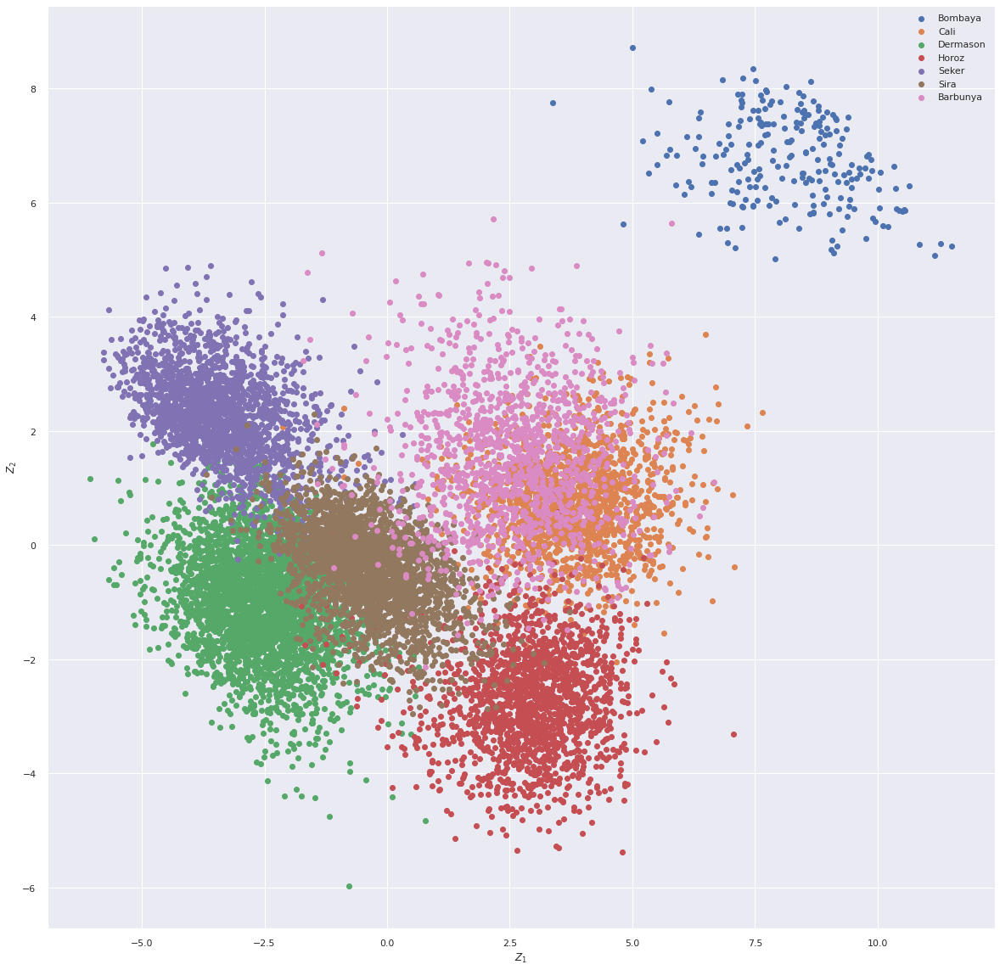

In [237]:
pca = PCA()
pca.fit(X)
Z = pca.fit_transform(X)

# yes->1,  no->0, 
idx_0 = np.where(y == 0)
idx_1 = np.where(y == 1)
idx_2 = np.where(y == 2)
idx_3 = np.where(y == 3)
idx_4 = np.where(y == 4)
idx_5 = np.where(y == 5)
idx_6 = np.where(y == 6)

plt. figure()
plt.scatter(Z[idx_1,0], Z[idx_1,1], label='Bombaya')
plt.scatter(Z[idx_2,0], Z[idx_2,1], label='Cali')
plt.scatter(Z[idx_3,0], Z[idx_3,1],label='Dermason')
plt.scatter(Z[idx_4,0], Z[idx_4,1],label='Horoz')
plt.scatter(Z[idx_5,0], Z[idx_5,1],label='Seker')
plt.scatter(Z[idx_6,0], Z[idx_6,1],label='Sira')
plt.scatter(Z[idx_0,0], Z[idx_0,1],label='Barbunya')z
plt.legend()
plt.xlabel('$Z_1$')
plt.ylabel('$Z_2$')
#for label, x, y in zip(observations,Z[:, 0],Z[:, 1]):
#    plt.annotate(label, xy=(x, y), xytext=(-2, 2),
#        textcoords='offset points', ha='right', va='bottom')

**Eigenvectors**

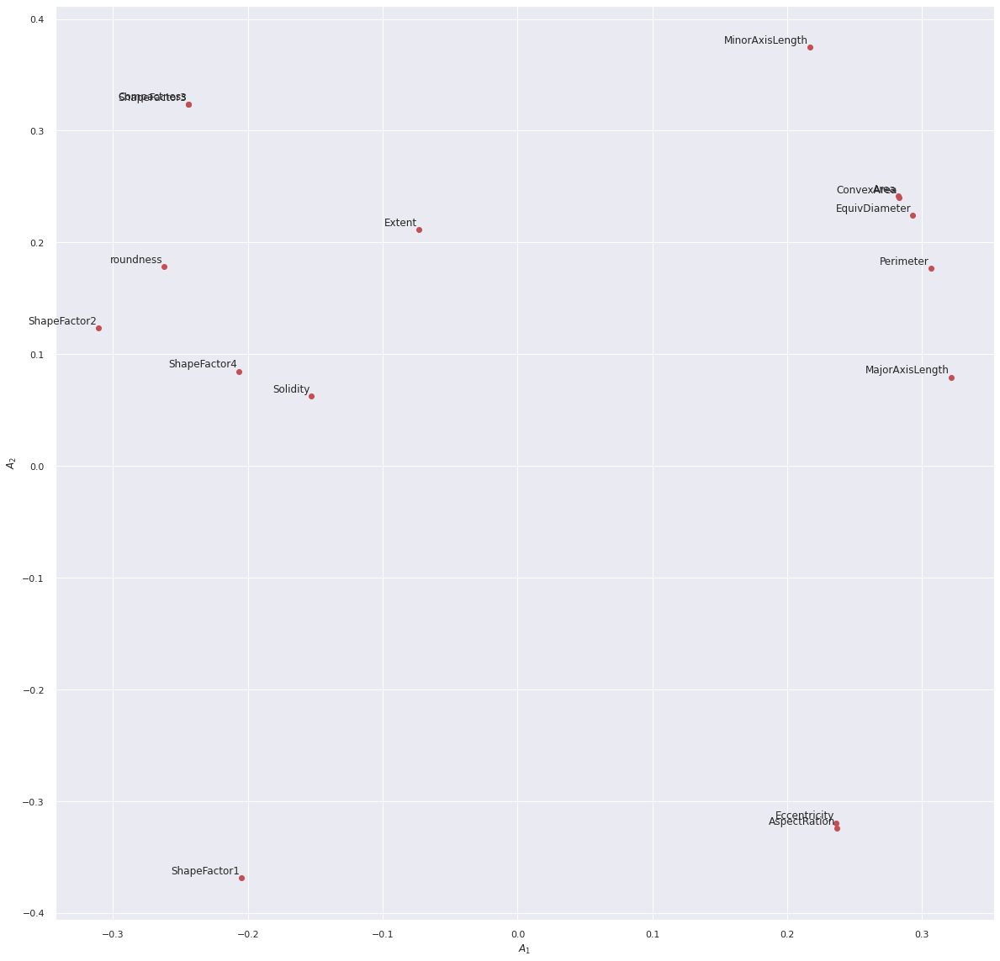

In [239]:
A = pca.components_.T 

plt.scatter(A[:,0],A[:,1],c='r')
plt.xlabel('$A_1$')
plt.ylabel('$A_2$')
for label, x, y in zip(variables, A[:, 0], A[:, 1]):
  plt.annotate(label, xy=(x, y), xytext=(-2, 2), textcoords='offset points', ha='right', va='bottom')

In [240]:
A[:,:3]

array([[ 0.28219126,  0.24137315, -0.07275685],
       [ 0.3064593 ,  0.17666006, -0.02148759],
       [ 0.3216921 ,  0.07930291, -0.10105623],
       [ 0.21663377,  0.37489566,  0.00110894],
       [ 0.23704187, -0.32438011, -0.16405693],
       [ 0.23621524, -0.3193313 , -0.14274973],
       [ 0.2828897 ,  0.24030507, -0.06388512],
       [ 0.2929353 ,  0.22428023, -0.06356255],
       [-0.07307317,  0.21140492, -0.13654558],
       [-0.15283082,  0.06220751, -0.77367504],
       [-0.26216501,  0.1783218 , -0.19146893],
       [-0.24422799,  0.32403098,  0.14341856],
       [-0.20476482, -0.36880804, -0.0084989 ],
       [-0.31112325,  0.12362832,  0.12426369],
       [-0.24438283,  0.32343884,  0.14087577],
       [-0.20660741,  0.08472819, -0.46777215]])

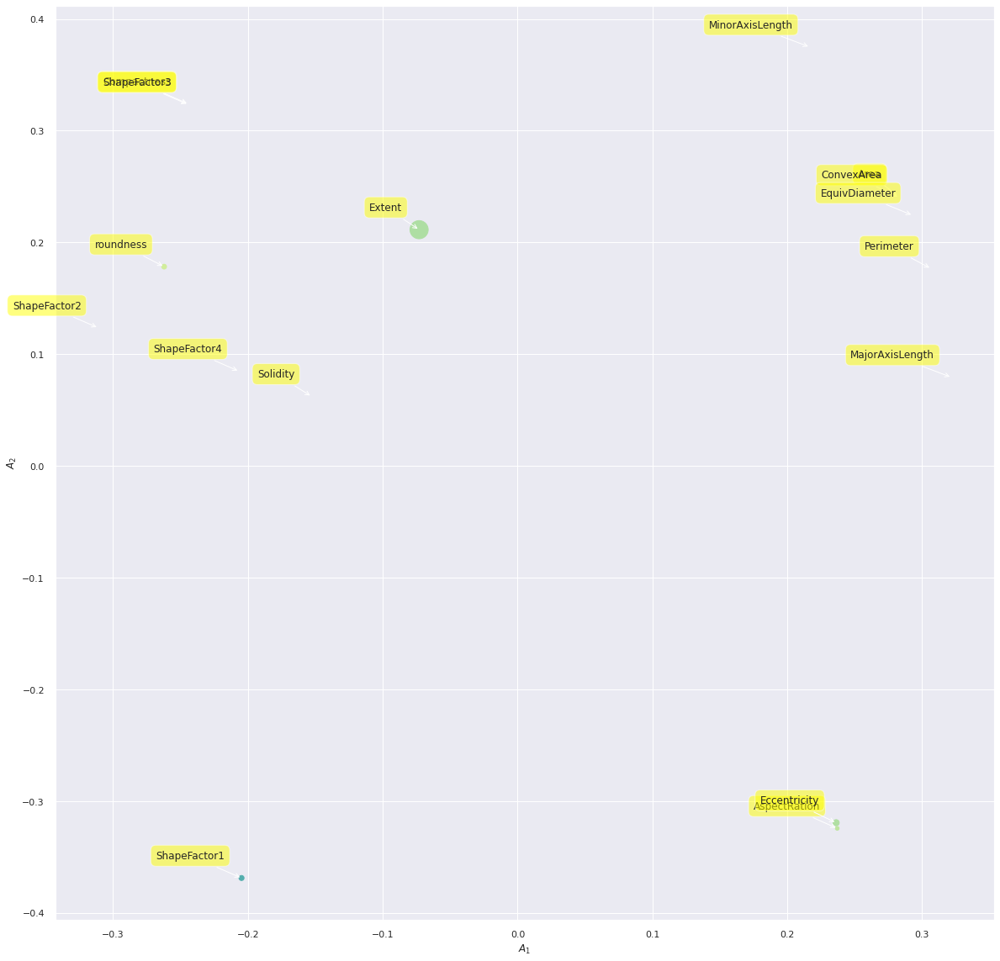

In [241]:
plt.scatter(A[:, 0],A[:, 1], marker='o', c=A[:, 2], s=A[:, 3]*500, cmap=plt.get_cmap('Spectral'))
plt.xlabel('$A_1$')
plt.ylabel('$A_2$')
for label, x, y in zip(variables,A[:, 0],A[:, 1]):
  plt.annotate(label,xy=(x, y), xytext=(-20, 20),
      textcoords='offset points', ha='right', va='bottom',
      bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
      arrowprops=dict(arrowstyle = '->', connectionstyle='arc3,rad=0'))

**Scree plot**

Text(0, 0.5, 'Explained variance')

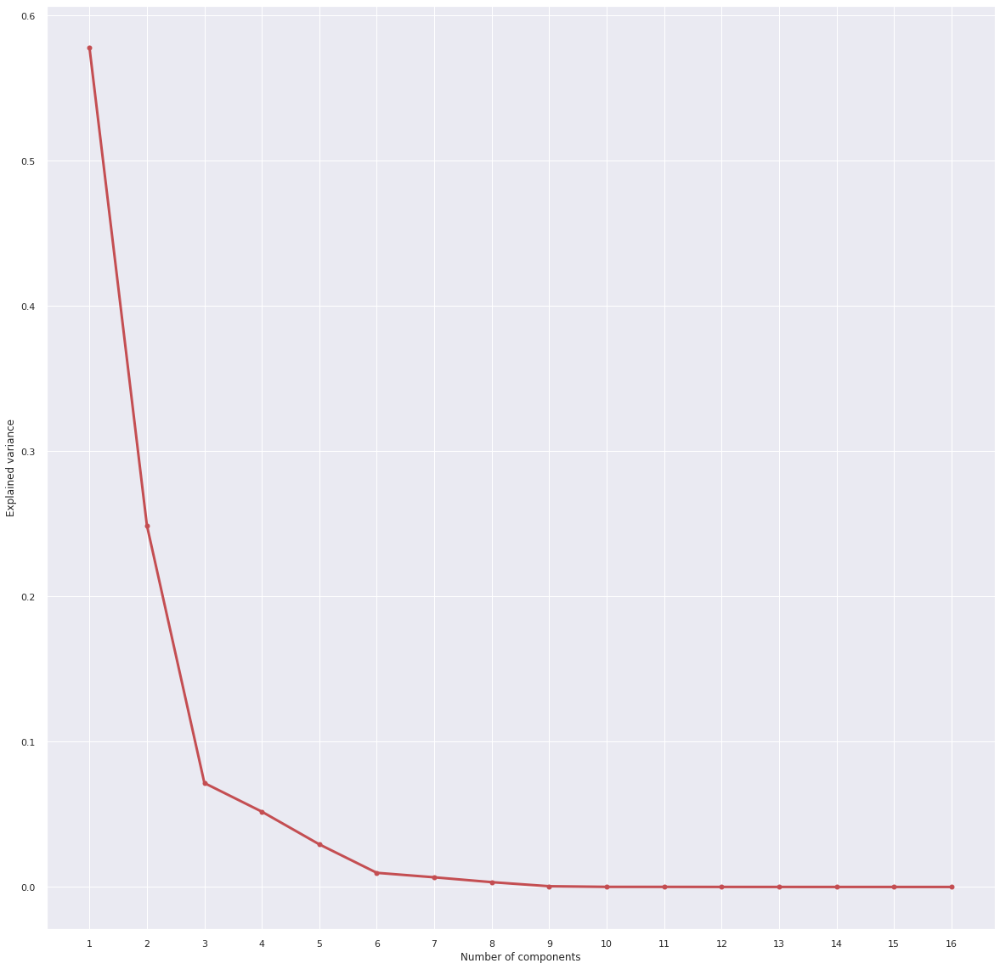

In [242]:
#Eigenvalues
Lambda = pca.explained_variance_ 

#Scree plot
x = np.arange(len(Lambda)) + 1
plt.plot(x,Lambda/sum(Lambda), 'ro-', lw=3)
plt.xticks(x, [""+str(i) for i in x], rotation=0)
plt.xlabel('Number of components')
plt.ylabel('Explained variance') 

In [243]:
print(Lambda[1])

3.982677937844835


**Explained Variance**

Text(0, 0.5, 'Cumulative explained variance')

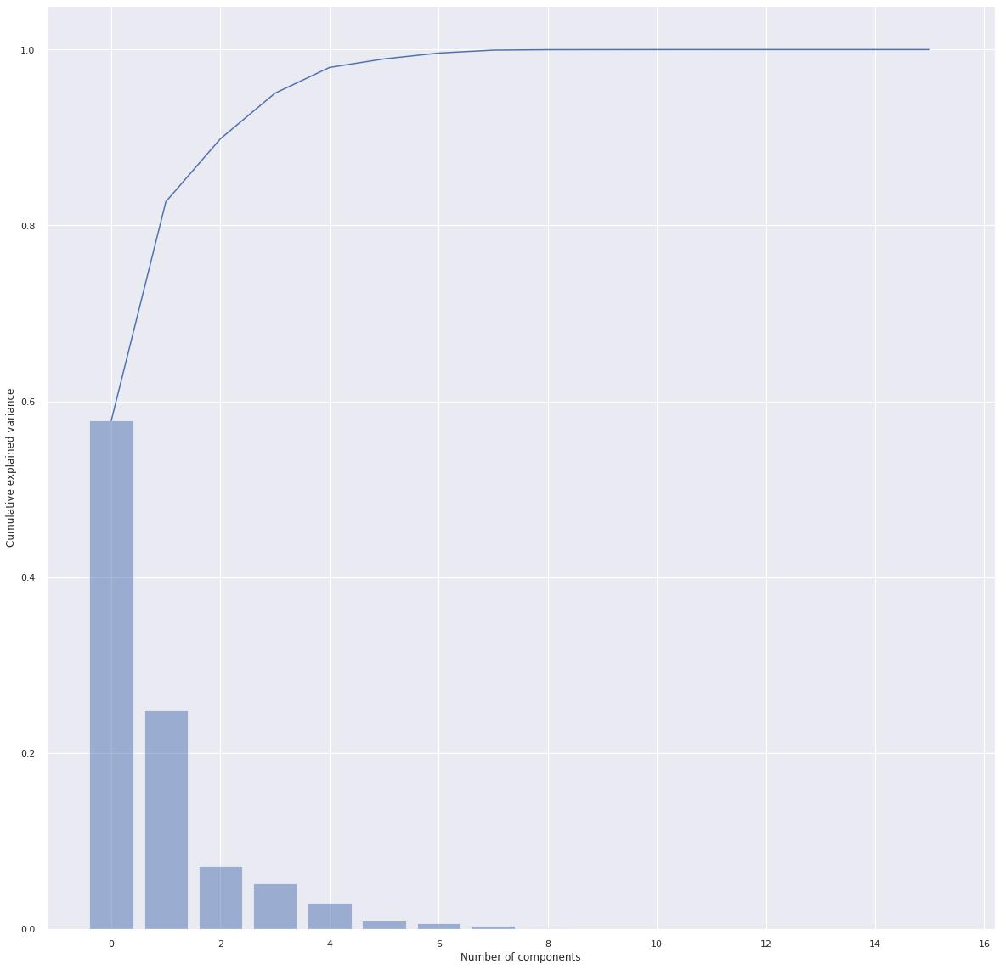

In [244]:
ell = pca.explained_variance_ratio_
ind = np.arange(len(ell))
plt.bar(ind, ell, align='center', alpha=0.5)
plt.plot(np.cumsum(ell))
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')

**Biplot**

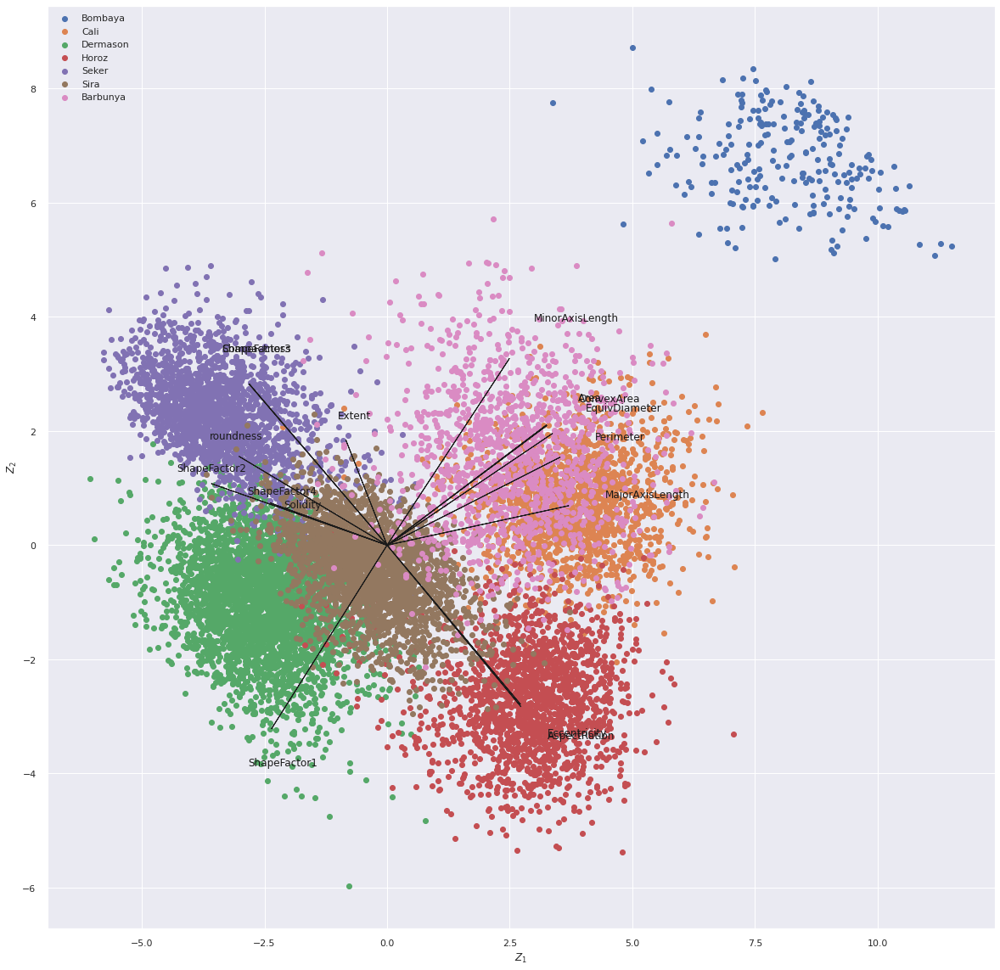

In [245]:
# 0,1 denote PC1 and PC2; change values for other PCs
A1 = A[:,0] 
A2 = A[:,1]
Z1 = Z[:,0] 
Z2 = Z[:,1]

plt.figure()
plt.xlabel('$Z_1$')
plt.ylabel('$Z_2$')
for i in range(len(A1)):
# arrows project features as vectors onto PC axes
  plt.arrow(0, 0, A1[i]*max(Z1), A2[i]*max(Z2), color='k', width=0.0005, head_width=0.0025)
  plt.text(A1[i]*max(Z1)*1.2, A2[i]*max(Z2)*1.2,variables[i], color='k')
plt.scatter(Z[idx_1,0], Z[idx_1,1], label='Bombaya')
plt.scatter(Z[idx_2,0], Z[idx_2,1], label='Cali')
plt.scatter(Z[idx_3,0], Z[idx_3,1],label='Dermason')
plt.scatter(Z[idx_4,0], Z[idx_4,1],label='Horoz')
plt.scatter(Z[idx_5,0], Z[idx_5,1],label='Seker')
plt.scatter(Z[idx_6,0], Z[idx_6,1],label='Sira')
plt.scatter(Z[idx_0,0], Z[idx_0,1],label='Barbunya')
plt.legend(loc='upper left')

**PCs Control Charts**

No handles with labels found to put in legend.
No handles with labels found to put in legend.


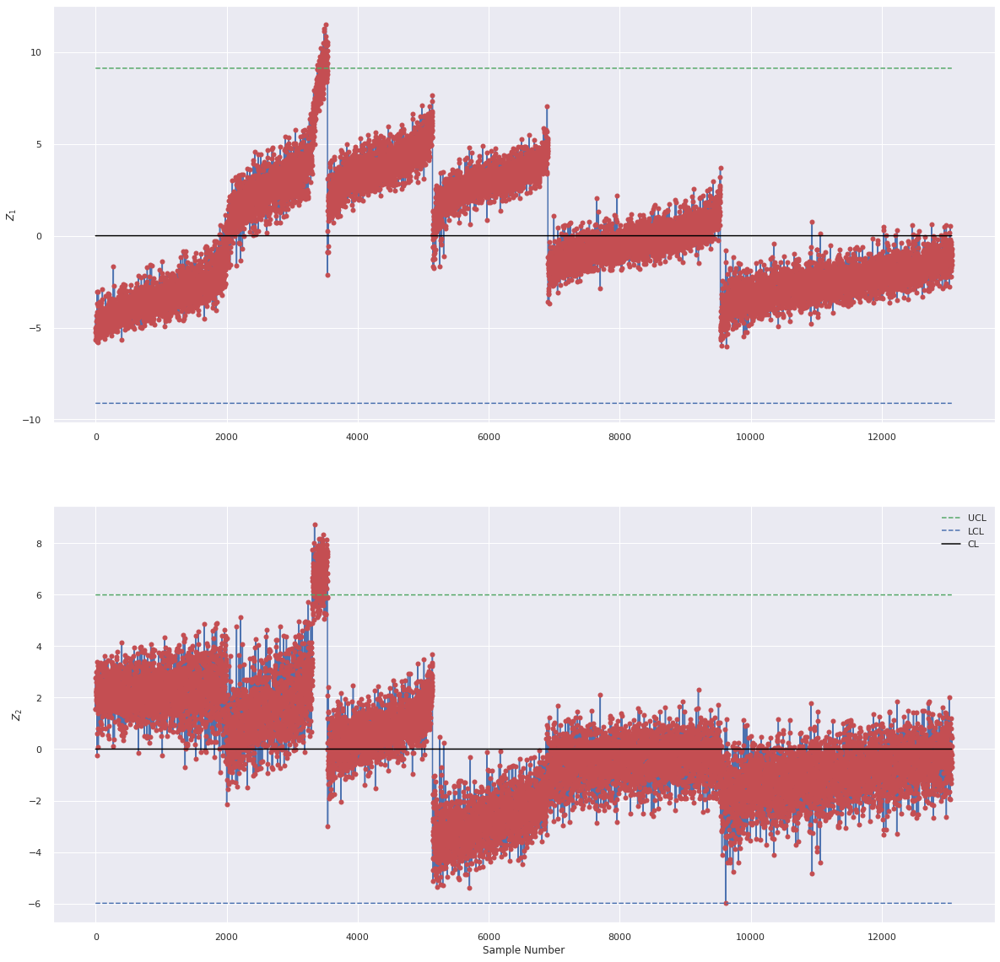

In [153]:
fig, (ax1, ax2) = plt.subplots(2,1)
ax1.plot(Z1,'-b', marker='o', mec='y',mfc='r')
ax1.plot([3*np.sqrt(Lambda[0]) for i in range(len(Z1))], "--g", label="UCL")
ax1.plot([-3*np.sqrt(Lambda[0]) for i in range(len(Z1))], "--b", label='LCL')
ax1.plot([0 for i in range(len(Z1))], "-", color='black',label='CL')
ax1.set_ylabel('$Z_1$')
legend = ax.legend(shadow=False, ncol=4, bbox_to_anchor=(0.85, -0.1))

ax2.plot(Z2,'-b', marker='o', mec='y',mfc='r')
ax2.plot([3*np.sqrt(Lambda[1]) for i in range(len(Z2))], "--g", label="UCL")
ax2.plot([-3*np.sqrt(Lambda[1]) for i in range(len(Z2))], "--b", label='LCL')
ax2.plot([0 for i in range(len(Z2))], "-", color='black',label='CL')
ax2.set_ylabel('$Z_2$')
ax2.set_xlabel('Sample Number')
legend = ax.legend(shadow=False, ncol=4, bbox_to_anchor=(0.85, -0.1))
plt.legend()

#**Using PCA Library**

In [154]:
!pip install pca

  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9675 sha256=eb9067bd91440fad58f8733c90f9a035cbdb70cfc87a58470e852df6c2855445
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget


In [155]:
from pca import pca
# Initialize and keep all PCs
model = pca(n_components=0.80)
# Fit transform
out = model.fit_transform(X)

[pca] >Processing dataframe..
[pca] >The PCA reduction is performed to capture [80.0%] explained variance using the [16] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [2] that covers the [80.00%] explained variance.
[pca] >The PCA reduction is performed on the [16] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[2]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]


**Principal Components**

In [156]:
out['PC']

,PC1,PC2
0,-5.236123,1.544593
1,-5.649331,2.762591
2,-5.002377,1.567754
3,-4.354662,1.883535
4,-5.182924,2.120804
...,...,...
13064,-1.064353,-0.493534
13065,-1.582428,0.445420
13066,-1.347728,0.110050
13067,-0.992788,-0.226181


**Scatter plot**

[pca] >Set parameter "label=None" to ignore the labels and significanly speed up the scatter plot.


(<Figure size 1440x1080 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5c4a3ad590>)

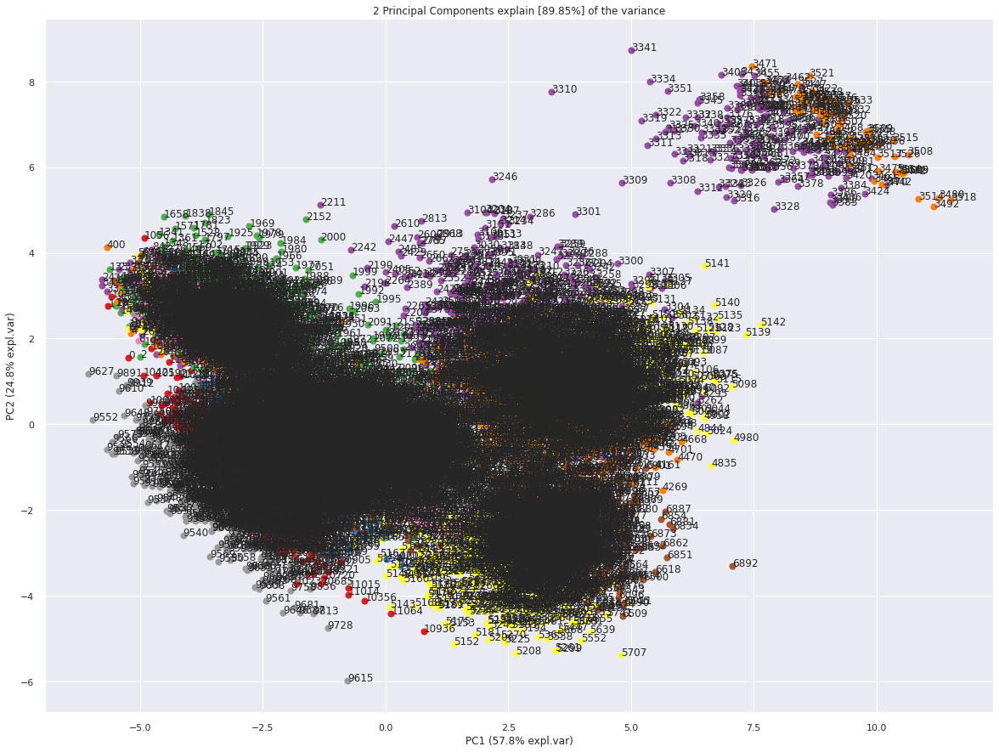

In [157]:
model.scatter(label=True, legend=False)

**Eigenvectors**

In [158]:
A = out['loadings'].T

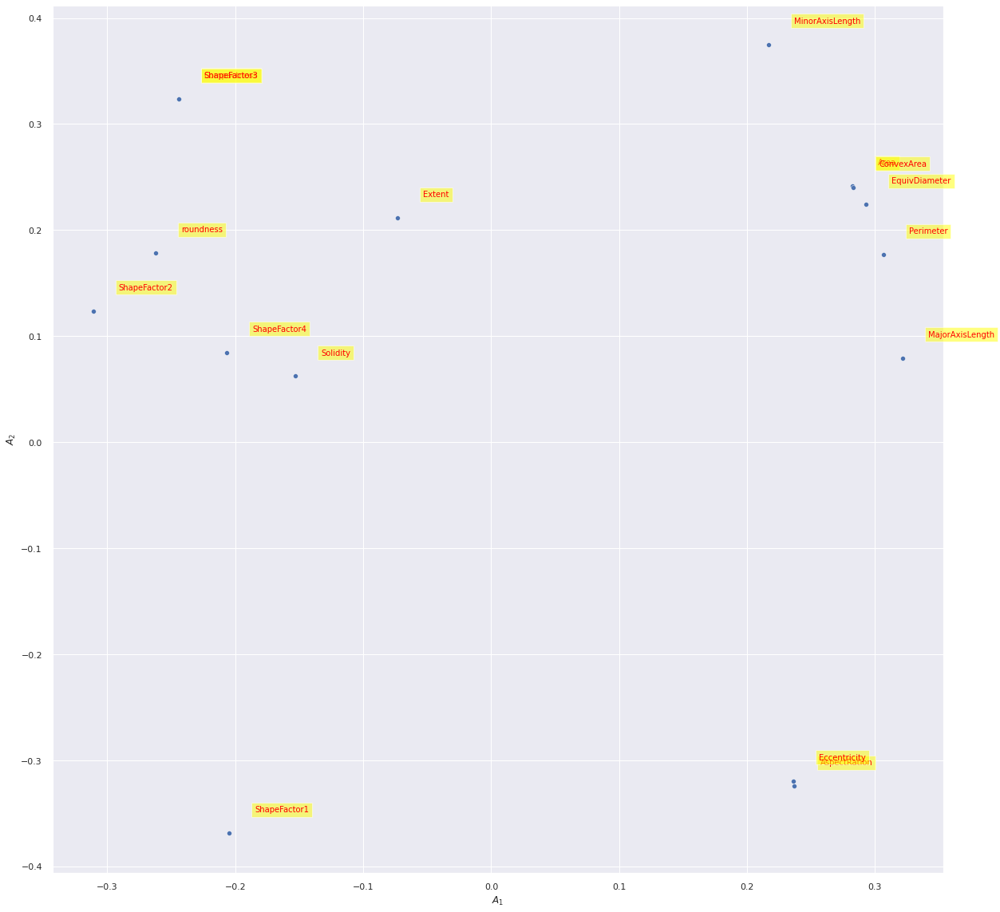

In [159]:
sns.scatterplot(data=A, x="PC1", y="PC2")
plt.xlabel('$A_1$')
plt.ylabel('$A_2$')
for i in range(A.shape[0]):
 plt.text(x=A.PC1[i]+0.02,y=A.PC2[i]+0.02, s=variables[i],
          fontdict=dict(color='red',size=10),
          bbox=dict(facecolor='yellow',alpha=0.5))

**Scree Plot**

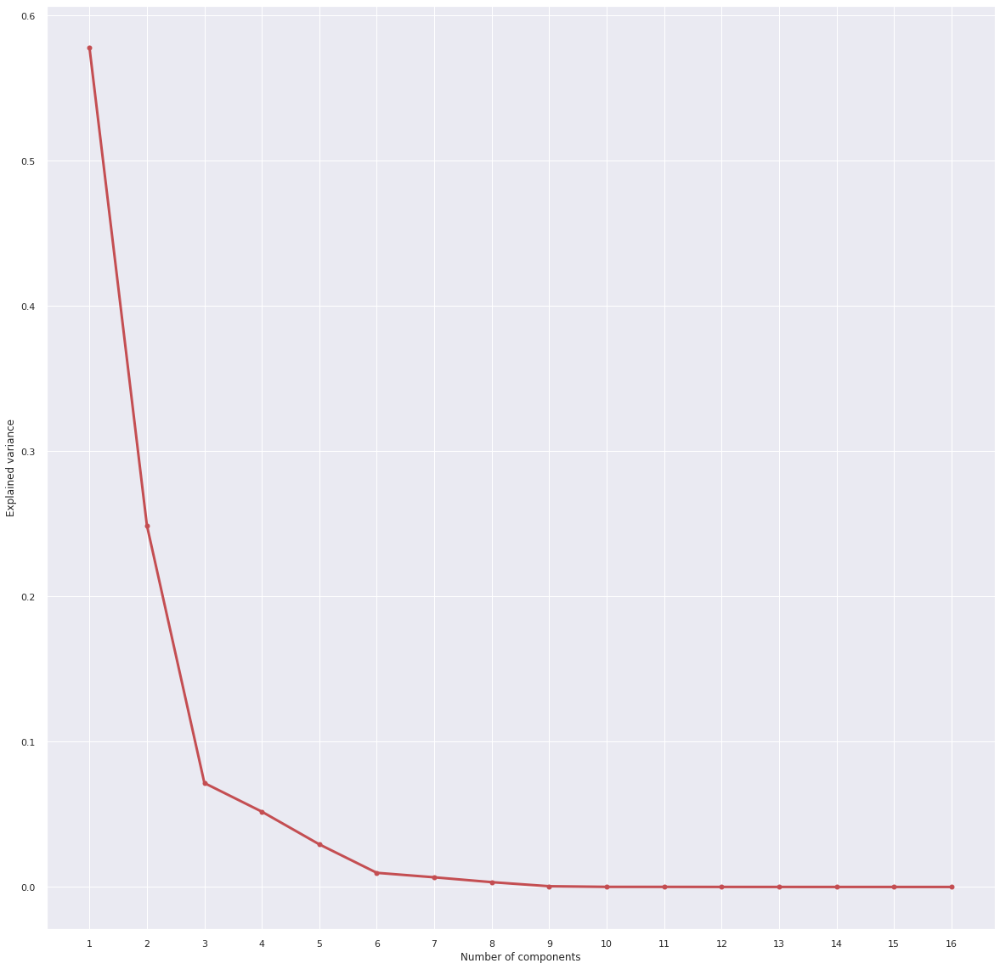

In [160]:
VR = out['variance_ratio']
x = np.arange(len(VR)) + 1
plt.plot(x, VR, 'ro-', lw=3)
plt.xticks(x, [""+str(i) for i in x], rotation=0)
plt.xlabel('Number of components')
plt.ylabel('Explained variance') 
plt.show()

**Explained Variance Plot**

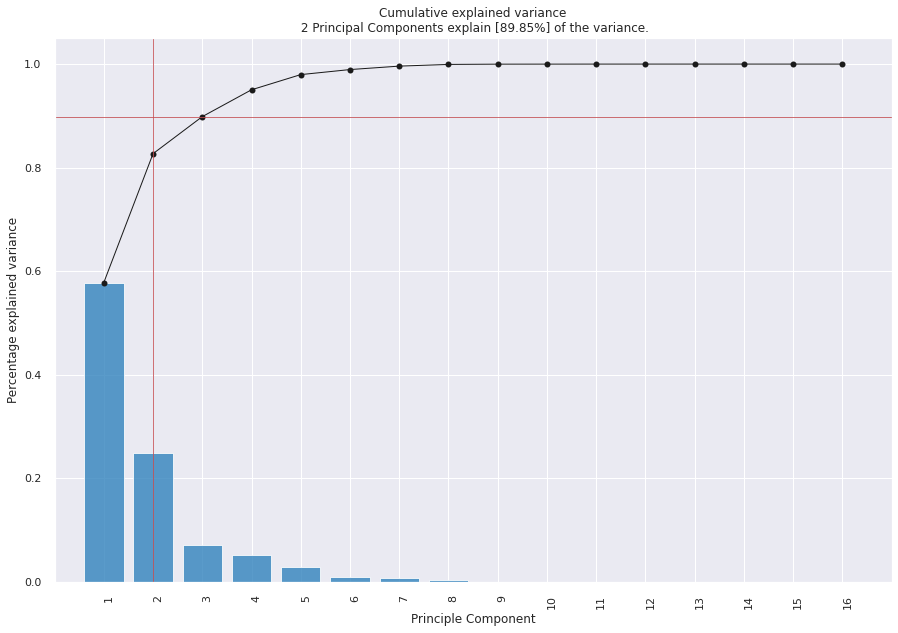

<Figure size 1440x1440 with 0 Axes>

In [161]:
model.plot();

**Biplot**

In [162]:
sns.set(rc = {'figure.figsize':(10,10)})


[pca] >Plot PC1 vs PC2 with loadings.
[pca] >Set parameter "label=None" to ignore the labels and significanly speed up the scatter plot.


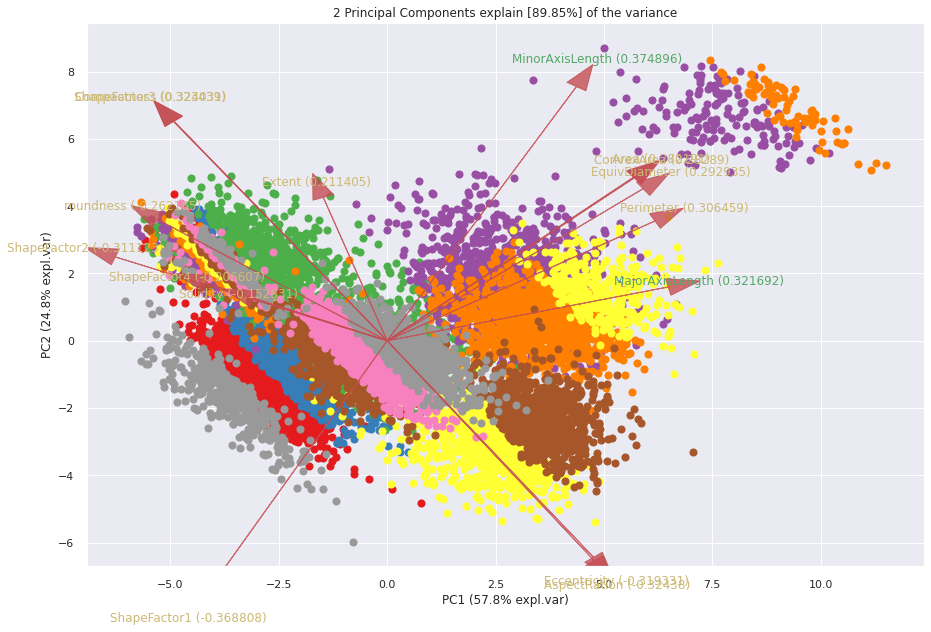

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5c475df710>)

In [163]:
sns.set(rc = {'figure.figsize':(10,10)})

model.biplot(label=False, legend=False)

In [164]:
model.biplot3d(legend=False)

[pca] >Requires 3 PCs to make 3d plot. Try to use biplot() instead.


(None, None)

#**Classification**

**Using PyCaret**

In [165]:
#Run the below code in your notebook to check the installed version
from pycaret.utils import version
version()

'2.3.10'

PyCaret uses interactive plotting ability. In order to render interactive plots in Google Colab, run the below line of code in your colab notebook.

In [166]:
#For Google Colab only
from pycaret.utils import enable_colab 
enable_colab()

Colab mode enabled.


In order to demonstrate the predict_model() function on unseen data, a sample of 1354 observations has been withheld from the original dataset to be used for predictions. This should not be confused with a train/test split as this particular split is performed to simulate a real life scenario. Another way to think about this is that these 1354 records were not available at the time when the machine learning experiment was performed.

In [167]:
data = df.sample(frac=0.9, random_state=786)
data_unseen = df.drop(data.index)

data.reset_index(drop=True, inplace=True)
data_unseen.reset_index(drop=True, inplace=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (11762, 17)
Unseen Data For Predictions: (1307, 17)


**Setting up the Environment in PyCaret**

The setup() function initializes the environment in pycaret and creates the transformation pipeline to prepare the data for modeling and deployment. setup() must be called before executing any other function in pycaret. It takes two mandatory parameters: a pandas dataframe and the name of the target column. All other parameters are optional and are used to customize the pre-processing pipeline (we will see them in later tutorials).

When setup() is executed, PyCaret's inference algorithm will automatically infer the data types for all features based on certain properties. The data type should be inferred correctly but this is not always the case. To account for this, PyCaret displays a table containing the features and their inferred data types after setup() is executed. If all of the data types are correctly identified enter can be pressed to continue or quit can be typed to end the expriment. Ensuring that the data types are correct is of fundamental importance in PyCaret as it automatically performs a few pre-processing tasks which are imperative to any machine learning experiment. These tasks are performed differently for each data type which means it is very important for them to be correctly configured.

In [168]:
from pycaret.classification import *
clf = setup(data=data, target='Class', train_size=0.7, session_id=123)

,Description,Value
0,session_id,123
1,Target,Class
2,Target Type,Multiclass
3,Label Encoded,None
4,Original Data,"(11762, 17)"
5,Missing Values,False
6,Numeric Features,16
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


Once the setup has been succesfully executed it prints the information grid which contains several important pieces of information. Most of the information is related to the pre-processing pipeline which is constructed when setup() is executed. The majority of these features are out of scope for the purposes of this tutorial however a few important things to note at this stage include:

* **session_id** : A pseduo-random number distributed as a seed in all functions for later reproducibility. If no session_id is passed, a random number is automatically generated that is distributed to all functions. In this experiment, the session_id is set as 123 for later reproducibility.

* **Target Type** : Binary or Multiclass. The Target type is automatically detected and shown. There is no difference in how the experiment is performed for Binary or Multiclass problems. All functionalities are identical.

* **Label Encoded** : When the Target variable is of type string (i.e. 'Yes' or 'No') instead of 1 or 0, it automatically encodes the label into 1 and 0 and displays the mapping (0 : No, 1 : Yes) for reference. 

* **Original Data** : Displays the original shape of the dataset. In this experiment (11762, 17) means 11762 samples and 17 features including the class column.

* **Missing Values** : When there are missing values in the original data this will show as True. For this experiment there are no missing values in the dataset.

* **Numeric Features** : The number of features inferred as numeric. In this dataset, 16 out of 17 features are inferred as numeric.

* **Categorical Features** : The number of features inferred as categorical. In this dataset, there are no categorical features.

* **Transformed Train Set** : Displays the shape of the transformed training set. Notice that the original shape of (11762, 17) is transformed into (8233, 14) for the transformed train set.

* **Transformed Test Set** : Displays the shape of the transformed test/hold-out set. There are 3529 samples in test/hold-out set. This split is based on the default value of 70/30 that can be changed using the train_size parameter in setup.

Notice how a few tasks that are imperative to perform modeling are automatically handled such as missing value imputation, categorical encoding etc. Most of the parameters in setup() are optional and used for customizing the pre-processing pipeline. 

**Comparing All Models**

In [169]:
 #show the best model and their statistics
 best_model = compare_models() 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9280,0.9931,0.9410,0.9287,0.9281,0.9120,0.9121,1.014
gbc,Gradient Boosting Classifier,0.9237,0.9927,0.9356,0.9244,0.9236,0.9068,0.9069,16.495
rf,Random Forest Classifier,0.9219,0.9914,0.9338,0.9225,0.9218,0.9046,0.9047,1.518
et,Extra Trees Classifier,0.9210,0.9914,0.9328,0.9218,0.9210,0.9035,0.9037,0.721
qda,Quadratic Discriminant Analysis,0.9138,0.9909,0.9290,0.9168,0.9140,0.8949,0.8955,0.021
lda,Linear Discriminant Analysis,0.9095,0.9912,0.9230,0.9169,0.9107,0.8895,0.8907,0.027
lr,Logistic Regression,0.9039,0.9897,0.9188,0.9048,0.9040,0.8826,0.8828,3.436
dt,Decision Tree Classifier,0.8932,0.9337,0.9109,0.8936,0.8931,0.8697,0.8698,0.105
ridge,Ridge Classifier,0.8818,0.0000,0.8898,0.8856,0.8804,0.8548,0.8568,0.015
nb,Naive Bayes,0.7893,0.9683,0.7964,0.7917,0.7874,0.7425,0.7434,0.020


**Create a Model**

create_model is the most granular function in PyCaret and is often the foundation behind most of the PyCaret functionalities. As the name suggests this function trains and evaluates a model using cross validation that can be set with fold parameter. The output prints a score grid that shows Accuracy, Recall, Precision, F1, Kappa and MCC by fold.

For the remaining part, we will work with the below models as our candidate models since they are the top performing. 

* Gradient Boosting Classifier ('gbc')
* Light Gradient Boosting Machine ('LightGBM')
* Random Forest ('rf')

There are many classifiers available in the model library of PyCaret. Please view the create_model() docstring for the list of all available models.

**Create Gradient Boosting Classifer**

In [170]:
gbc = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9284,0.9946,0.9427,0.9292,0.9285,0.9126,0.9127
1,0.9235,0.9937,0.9376,0.9236,0.9231,0.9066,0.9068
2,0.9333,0.9945,0.9465,0.9333,0.9331,0.9186,0.9187
3,0.9259,0.9907,0.9325,0.9277,0.9261,0.9092,0.9095
4,0.9210,0.9918,0.9382,0.9212,0.9210,0.9034,0.9035
5,0.9149,0.9932,0.9209,0.9160,0.9150,0.8962,0.8963
6,0.9283,0.9924,0.9419,0.9289,0.9284,0.9124,0.9125
7,0.9125,0.9930,0.9225,0.9131,0.9120,0.8930,0.8933
8,0.9320,0.9913,0.9428,0.9334,0.9320,0.9167,0.9170


In [171]:
#trained model object is stored in the variable 'dt'. 
gbc

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

**Tune a Model:** How to automatically tune the hyper-parameters of a multiclass model. When a model is created using the create_model() function it uses the default hyperparameters. In order to tune hyperparameters, the tune_model() function is used. The tune_model() function is a random grid search of hyperparameters over a pre-defined search space. By default, it is set to optimize Accuracy but this can be changed using optimize parameter. This function automatically tunes the hyperparameters of a model on a pre-defined search space and scores it using stratified cross validation. The output prints a score grid that shows Accuracy, AUC, Recall, Precision, F1 and Kappa by fold.

**Tune Gradient Boosting Classifer**

In [172]:
tuned_gbc = tune_model(gbc)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9320,0.9944,0.9454,0.9322,0.9320,0.9171,0.9171
1,0.9223,0.9928,0.9366,0.9228,0.9219,0.9051,0.9054
2,0.9272,0.9938,0.9425,0.9274,0.9271,0.9112,0.9113
3,0.9332,0.9883,0.9400,0.9350,0.9334,0.9182,0.9184
4,0.9149,0.9919,0.9318,0.9154,0.9150,0.8960,0.8961
5,0.9222,0.9933,0.9251,0.9225,0.9221,0.9050,0.9051
6,0.9149,0.9927,0.9316,0.9159,0.9152,0.8960,0.8961
7,0.9198,0.9930,0.9334,0.9198,0.9194,0.9020,0.9022
8,0.9247,0.9914,0.9394,0.9258,0.9248,0.9079,0.9081


In [173]:
#tuned model object is stored in the variable 'tuned_dt'. 
tuned_gbc

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.15, loss='deviance', max_depth=7,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.02, min_impurity_split=None,
                           min_samples_leaf=5, min_samples_split=5,
                           min_weight_fraction_leaf=0.0, n_estimators=230,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=0.85, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

**Evaluate  Gradient Boosting Classifer**

Update statmodels

In [174]:
!pip install statsmodels --upgrade

     |████████████████████████████████| 9.8 MB 12.4 MB/s 
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2


How to analyze model performance using various plots

In [176]:
evaluate_model(tuned_gbc) # 0.931

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**Create LighGBM Model**

In [177]:
lightgbm = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9296,0.9949,0.9459,0.9302,0.9298,0.9141,0.9142
1,0.9248,0.9935,0.9429,0.9247,0.9246,0.9081,0.9082
2,0.9466,0.9950,0.9583,0.9466,0.9465,0.9349,0.9349
3,0.9307,0.9907,0.9376,0.9328,0.9310,0.9152,0.9155
4,0.9174,0.9919,0.9337,0.9186,0.9177,0.8989,0.8990
5,0.9332,0.9938,0.9353,0.9335,0.9331,0.9184,0.9184
6,0.9174,0.9934,0.9352,0.9185,0.9177,0.8990,0.8991
7,0.9247,0.9922,0.9365,0.9251,0.9246,0.9079,0.9080
8,0.9307,0.9931,0.9442,0.9323,0.9311,0.9154,0.9155


**Tune LighGBM Model**

In [178]:
tuned_lightgbm = tune_model(lightgbm)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9260,0.9952,0.9396,0.9270,0.9261,0.9097,0.9098
1,0.9223,0.9935,0.9393,0.9221,0.9219,0.9052,0.9053
2,0.9442,0.9949,0.9537,0.9440,0.9440,0.9319,0.9319
3,0.9259,0.9916,0.9325,0.9279,0.9261,0.9093,0.9095
4,0.9235,0.9935,0.9379,0.9247,0.9239,0.9063,0.9064
5,0.9247,0.9940,0.9287,0.9257,0.9247,0.9080,0.9081
6,0.9259,0.9937,0.9413,0.9261,0.9258,0.9094,0.9095
7,0.9198,0.9929,0.9315,0.9196,0.9195,0.9020,0.9021
8,0.9344,0.9925,0.9458,0.9357,0.9346,0.9198,0.9199


**Evaluate LighGBM Model**

In [179]:
evaluate_model(tuned_lightgbm) #0.932

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**Create Random Forest Model**

In [180]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9248,0.9940,0.9372,0.9257,0.9250,0.9082,0.9083
1,0.9163,0.9906,0.9323,0.9163,0.9158,0.8977,0.8980
2,0.9393,0.9940,0.9511,0.9395,0.9392,0.9260,0.9261
3,0.9222,0.9866,0.9283,0.9241,0.9224,0.9048,0.9050
4,0.9125,0.9911,0.9288,0.9132,0.9127,0.8930,0.8930
5,0.9162,0.9926,0.9196,0.9173,0.9158,0.8976,0.8979
6,0.9247,0.9927,0.9406,0.9250,0.9247,0.9079,0.9080
7,0.9149,0.9894,0.9283,0.9152,0.9144,0.8960,0.8964
8,0.9307,0.9916,0.9406,0.9318,0.9308,0.9153,0.9155


**Tune Random Forest Model**

In [181]:
tuned_rf = tune_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9090,0.9914,0.9236,0.9136,0.9100,0.8889,0.8896
1,0.8968,0.9896,0.9107,0.8974,0.8969,0.8740,0.8741
2,0.9284,0.9927,0.9439,0.9305,0.9286,0.9128,0.9133
3,0.9125,0.9884,0.9173,0.9165,0.9130,0.8930,0.8937
4,0.8870,0.9883,0.8973,0.8894,0.8874,0.8619,0.8623
5,0.8931,0.9886,0.9046,0.8974,0.8934,0.8697,0.8704
6,0.9089,0.9915,0.9229,0.9103,0.9094,0.8887,0.8888
7,0.8846,0.9891,0.8919,0.8848,0.8844,0.8590,0.8591
8,0.8919,0.9904,0.9052,0.8988,0.8931,0.8680,0.8692


**Evaluate Random Forest Model**

In [182]:
evaluate_model(tuned_rf)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

#**Classification + 2 PC**

In [194]:
clf_pca = setup(data=data, target='Class', train_size=0.7, session_id=123, normalize = True, pca = True, pca_components = 2)

,Description,Value
0,session_id,123
1,Target,Class
2,Target Type,Multiclass
3,Label Encoded,None
4,Original Data,"(11762, 17)"
5,Missing Values,False
6,Numeric Features,16
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


In [195]:
#show the best model and their statistics
best_model_pca = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lr,Logistic Regression,0.8641,0.9851,0.8607,0.8640,0.8628,0.8339,0.8343,0.339
qda,Quadratic Discriminant Analysis,0.8601,0.9851,0.8570,0.8616,0.8580,0.8291,0.8300,0.019
gbc,Gradient Boosting Classifier,0.8574,0.9815,0.8502,0.8564,0.8555,0.8257,0.8261,4.035
lda,Linear Discriminant Analysis,0.8566,0.9838,0.8537,0.8573,0.8549,0.8248,0.8255,0.020
nb,Naive Bayes,0.8544,0.9831,0.8519,0.8551,0.8516,0.8220,0.8229,0.019
knn,K Neighbors Classifier,0.8466,0.9642,0.8428,0.8459,0.8457,0.8125,0.8127,0.134
lightgbm,Light Gradient Boosting Machine,0.8449,0.9812,0.8397,0.8443,0.8431,0.8103,0.8108,0.564
rf,Random Forest Classifier,0.8439,0.9769,0.8389,0.8429,0.8427,0.8092,0.8095,0.869
et,Extra Trees Classifier,0.8388,0.9765,0.8329,0.8377,0.8374,0.8030,0.8033,0.670
dt,Decision Tree Classifier,0.8088,0.8853,0.8077,0.8103,0.8090,0.7666,0.7668,0.030


**Gradient Boosting Classifier**

In [196]:
gbc_pca = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8556,0.9827,0.8501,0.8549,0.8549,0.8237,0.8238
1,0.8447,0.9824,0.8375,0.8433,0.8429,0.8099,0.8103
2,0.8859,0.9848,0.8780,0.8865,0.8842,0.8608,0.8615
3,0.8603,0.9799,0.8507,0.8595,0.8575,0.8289,0.8296
4,0.8384,0.9776,0.8341,0.8375,0.8360,0.8024,0.8030
5,0.8651,0.9834,0.8640,0.8631,0.8633,0.8352,0.8355
6,0.8712,0.9846,0.8578,0.8709,0.8697,0.8425,0.8429
7,0.8372,0.9800,0.8285,0.8338,0.8341,0.8008,0.8013
8,0.8578,0.9819,0.8471,0.8588,0.8576,0.8261,0.8264


In [197]:
# Tune hyperparameters with scikit-learn (default)
tuned_gbc_pca = tune_model(gbc_pca)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8604,0.9820,0.8544,0.8591,0.8596,0.8295,0.8296
1,0.8507,0.9813,0.8421,0.8487,0.8484,0.8173,0.8178
2,0.8835,0.9841,0.8716,0.8831,0.8808,0.8578,0.8586
3,0.8651,0.9782,0.8552,0.8646,0.8621,0.8347,0.8355
4,0.8481,0.9789,0.8426,0.8475,0.8457,0.8142,0.8149
5,0.8615,0.9838,0.8604,0.8588,0.8594,0.8307,0.8310
6,0.8761,0.9855,0.8708,0.8757,0.8745,0.8483,0.8487
7,0.8457,0.9798,0.8365,0.8416,0.8420,0.8111,0.8116
8,0.8712,0.9818,0.8618,0.8728,0.8708,0.8424,0.8428


In [198]:
evaluate_model(tuned_gbc_pca)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**Random Forest**

In [199]:
rf_pca = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8422,0.9770,0.8367,0.8416,0.8418,0.8073,0.8074
1,0.8325,0.9767,0.8281,0.8323,0.8321,0.7953,0.7954
2,0.8617,0.9812,0.8538,0.8610,0.8607,0.8313,0.8315
3,0.8603,0.9728,0.8505,0.8588,0.8585,0.8288,0.8292
4,0.8323,0.9744,0.8276,0.8298,0.8307,0.7950,0.7951
5,0.8372,0.9780,0.8381,0.8356,0.8362,0.8012,0.8013
6,0.8457,0.9782,0.8388,0.8431,0.8436,0.8112,0.8115
7,0.8323,0.9728,0.8264,0.8297,0.8303,0.7949,0.7951
8,0.8505,0.9779,0.8439,0.8544,0.8516,0.8173,0.8176


In [200]:
# Tune hyperparameters with scikit-learn (default)
tuned_rf_pca = tune_model(rf_pca)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8519,0.9810,0.8509,0.8535,0.8517,0.8195,0.8199
1,0.8228,0.9786,0.8291,0.8256,0.8223,0.7839,0.7847
2,0.8799,0.9843,0.8785,0.8804,0.8795,0.8536,0.8539
3,0.8518,0.9796,0.8517,0.8517,0.8515,0.8189,0.8190
4,0.8457,0.9769,0.8439,0.8443,0.8432,0.8115,0.8120
5,0.8603,0.9814,0.8629,0.8589,0.8593,0.8295,0.8296
6,0.8724,0.9850,0.8748,0.8725,0.8719,0.8440,0.8442
7,0.8348,0.9761,0.8341,0.8338,0.8333,0.7983,0.7986
8,0.8445,0.9792,0.8452,0.8512,0.8462,0.8103,0.8109


In [201]:
evaluate_model(tuned_rf_pca)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**LightGBM**

In [202]:
lgbm_pca = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8386,0.9815,0.8370,0.8384,0.8380,0.8029,0.8031
1,0.8386,0.9810,0.8316,0.8369,0.8375,0.8027,0.8028
2,0.8629,0.9842,0.8585,0.8627,0.8617,0.8327,0.8331
3,0.8481,0.9786,0.8375,0.8479,0.8446,0.8138,0.8148
4,0.8238,0.9795,0.8208,0.8217,0.8214,0.7842,0.7847
5,0.8408,0.9823,0.8365,0.8388,0.8394,0.8056,0.8058
6,0.8603,0.9828,0.8575,0.8594,0.8579,0.8290,0.8296
7,0.8299,0.9774,0.8228,0.8265,0.8272,0.7921,0.7924
8,0.8457,0.9814,0.8413,0.8496,0.8465,0.8113,0.8116


In [203]:
tuned_lgbm_pca = tune_model(lgbm_pca)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8544,0.9839,0.8496,0.8536,0.8529,0.8223,0.8228
1,0.8495,0.9826,0.8348,0.8477,0.8474,0.8159,0.8163
2,0.8908,0.9861,0.8830,0.8911,0.8887,0.8667,0.8674
3,0.8651,0.9819,0.8547,0.8647,0.8624,0.8348,0.8356
4,0.8493,0.9811,0.8438,0.8483,0.8470,0.8157,0.8162
5,0.8578,0.9862,0.8489,0.8555,0.8558,0.8264,0.8266
6,0.8688,0.9862,0.8658,0.8691,0.8673,0.8395,0.8400
7,0.8360,0.9805,0.8280,0.8323,0.8328,0.7994,0.7998
8,0.8724,0.9832,0.8619,0.8730,0.8715,0.8440,0.8444


In [204]:
evaluate_model(tuned_lgbm_pca)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

#Classification with all PCs

In [183]:
clf_pca_all = setup(data=data, target='Class', train_size=0.7, session_id=123, normalize = True, pca = True, pca_components = 14)

,Description,Value
0,session_id,123
1,Target,Class
2,Target Type,Multiclass
3,Label Encoded,None
4,Original Data,"(11762, 17)"
5,Missing Values,False
6,Numeric Features,16
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


In [184]:
#show the best model and their statistics
best_model_pca_all = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.9282,0.9926,0.9396,0.9291,0.9283,0.9123,0.9124,0.729
rf,Random Forest Classifier,0.9280,0.9924,0.9395,0.9286,0.9280,0.9120,0.9121,1.563
lr,Logistic Regression,0.9258,0.9934,0.9388,0.9265,0.9258,0.9094,0.9095,0.709
lightgbm,Light Gradient Boosting Machine,0.9243,0.9929,0.9365,0.9251,0.9243,0.9076,0.9077,1.240
knn,K Neighbors Classifier,0.9232,0.9822,0.9364,0.9241,0.9232,0.9062,0.9064,0.141
gbc,Gradient Boosting Classifier,0.9231,0.9920,0.9342,0.9239,0.9231,0.9061,0.9062,16.687
svm,SVM - Linear Kernel,0.9163,0.0000,0.9299,0.9192,0.9167,0.8979,0.8983,0.091
qda,Quadratic Discriminant Analysis,0.9158,0.9909,0.9306,0.9184,0.9161,0.8974,0.8979,0.021
lda,Linear Discriminant Analysis,0.9085,0.9912,0.9222,0.9162,0.9097,0.8883,0.8896,0.028
ridge,Ridge Classifier,0.9060,0.0000,0.9187,0.9119,0.9070,0.8852,0.8861,0.016


**Gradient Boosting Classifier**

In [185]:
gbc_pca_all = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9320,0.9938,0.9423,0.9330,0.9322,0.9171,0.9172
1,0.9211,0.9924,0.9380,0.9214,0.9211,0.9036,0.9037
2,0.9393,0.9949,0.9503,0.9398,0.9394,0.9260,0.9261
3,0.9295,0.9916,0.9358,0.9316,0.9299,0.9137,0.9140
4,0.9064,0.9887,0.9238,0.9076,0.9069,0.8856,0.8857
5,0.9125,0.9898,0.9163,0.9128,0.9124,0.8932,0.8933
6,0.9283,0.9922,0.9332,0.9287,0.9283,0.9124,0.9125
7,0.9149,0.9928,0.9272,0.9151,0.9144,0.8960,0.8963
8,0.9356,0.9927,0.9485,0.9373,0.9359,0.9214,0.9216


In [186]:
# Tune hyperparameters with scikit-learn (default)
tuned_gbc_pca_all = tune_model(gbc_pca_all)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9357,0.9934,0.9456,0.9363,0.9358,0.9215,0.9216
1,0.9235,0.9920,0.9362,0.9242,0.9237,0.9065,0.9066
2,0.9490,0.9948,0.9573,0.9493,0.9491,0.9378,0.9378
3,0.9210,0.9897,0.9253,0.9228,0.9212,0.9032,0.9035
4,0.9125,0.9911,0.9203,0.9142,0.9131,0.8930,0.8931
5,0.9247,0.9930,0.9379,0.9252,0.9246,0.9081,0.9082
6,0.9271,0.9925,0.9396,0.9280,0.9273,0.9108,0.9110
7,0.9137,0.9919,0.9216,0.9140,0.9134,0.8945,0.8947
8,0.9429,0.9918,0.9538,0.9443,0.9431,0.9302,0.9303


In [187]:
evaluate_model(tuned_gbc_pca_all)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**Random Forest**

In [188]:
rf_pca_all = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9393,0.9939,0.9512,0.9396,0.9394,0.9260,0.9260
1,0.9248,0.9927,0.9390,0.9250,0.9247,0.9081,0.9082
2,0.9478,0.9939,0.9584,0.9480,0.9478,0.9363,0.9364
3,0.9332,0.9892,0.9394,0.9345,0.9334,0.9182,0.9184
4,0.9064,0.9925,0.9240,0.9073,0.9067,0.8856,0.8857
5,0.9295,0.9932,0.9318,0.9302,0.9294,0.9140,0.9141
6,0.9283,0.9931,0.9419,0.9296,0.9288,0.9124,0.9124
7,0.9149,0.9904,0.9267,0.9151,0.9145,0.8960,0.8962
8,0.9417,0.9925,0.9541,0.9427,0.9419,0.9287,0.9288


In [189]:
# Tune hyperparameters with scikit-learn (default)
tuned_rf_pca_all = tune_model(rf_pca_all)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9150,0.9913,0.9317,0.9155,0.9149,0.8965,0.8966
1,0.9017,0.9890,0.9206,0.9016,0.9015,0.8801,0.8801
2,0.9381,0.9933,0.9532,0.9402,0.9382,0.9246,0.9251
3,0.9028,0.9875,0.9126,0.9057,0.9032,0.8812,0.8816
4,0.8931,0.9859,0.9163,0.8949,0.8937,0.8695,0.8697
5,0.9077,0.9892,0.9297,0.9097,0.9078,0.8876,0.8880
6,0.9174,0.9904,0.9343,0.9186,0.9177,0.8992,0.8993
7,0.9028,0.9884,0.9167,0.9047,0.9029,0.8814,0.8817
8,0.9259,0.9887,0.9390,0.9281,0.9264,0.9095,0.9098


In [190]:
evaluate_model(tuned_rf_pca_all)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**LightGBM**

In [191]:
lgbm_pca_all = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9308,0.9932,0.9435,0.9307,0.9307,0.9156,0.9157
1,0.9199,0.9941,0.9351,0.9198,0.9196,0.9021,0.9023
2,0.9442,0.9944,0.9553,0.9445,0.9441,0.9319,0.9320
3,0.9320,0.9911,0.9394,0.9337,0.9323,0.9168,0.9170
4,0.9162,0.9922,0.9321,0.9174,0.9166,0.8975,0.8975
5,0.9198,0.9936,0.9222,0.9203,0.9198,0.9021,0.9022
6,0.9198,0.9928,0.9371,0.9212,0.9202,0.9019,0.9021
7,0.9174,0.9921,0.9283,0.9178,0.9167,0.8990,0.8994
8,0.9332,0.9927,0.9464,0.9345,0.9334,0.9183,0.9185


In [192]:
tuned_lgbm_pca_all = tune_model(lgbm_pca_all)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9320,0.9941,0.9443,0.9321,0.9320,0.9171,0.9171
1,0.9320,0.9934,0.9476,0.9320,0.9319,0.9171,0.9171
2,0.9442,0.9948,0.9571,0.9443,0.9440,0.9319,0.9320
3,0.9307,0.9921,0.9372,0.9324,0.9311,0.9153,0.9155
4,0.9162,0.9926,0.9316,0.9177,0.9167,0.8975,0.8975
5,0.9259,0.9941,0.9293,0.9269,0.9259,0.9096,0.9098
6,0.9235,0.9939,0.9402,0.9241,0.9237,0.9065,0.9065
7,0.9113,0.9926,0.9218,0.9114,0.9108,0.8916,0.8918
8,0.9344,0.9926,0.9485,0.9358,0.9347,0.9198,0.9200


In [193]:
evaluate_model(tuned_lgbm_pca_all)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
# 0.931
# F1 Scores from above
#GBC = (0.923, 0.927, 0.862)
#RF = (0.902, 0.91, 0.852)
#GBM = (0.928, 0.927, 0.859)


#F1-Score comparison

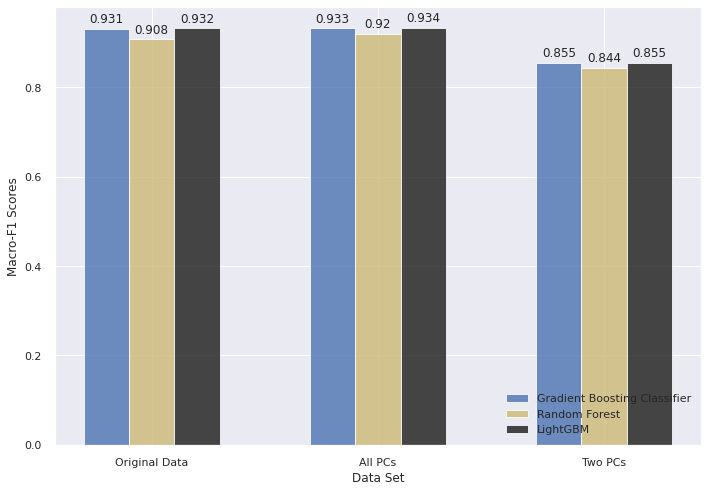

In [205]:
# ADAPTED FROM: https://matplotlib.org/3.1.1/gallery/lines_bars_and_markers/barchart.html
def autolabel(rects):
    for r in rects:
        height = r.get_height()
        ax.annotate(f'{height}', xy=(r.get_x() + r.get_width() / 2, height), xytext=(0, 3), textcoords="offset points", ha='center', va='bottom')

n_groups = 3
ind = np.arange(n_groups)

# F1 Scores from above
GBC = (0.931, 0.933, 0.855)
RF = (0.908, 0.92, 0.844)
GBM = (0.932, 0.934, 0.855)

# create plot
fig, ax = plt.subplots(figsize=(10,7))
index = np.arange(n_groups)
bar_width = 0.20
opacity = 0.8

rects1 = plt.bar(index, GBC, bar_width, alpha=opacity, color='b', label='Gradient Boosting Classifier')
rects2 = plt.bar(index + bar_width, RF, bar_width, alpha=opacity, color='y', label='Random Forest')
rects3 = plt.bar(index + bar_width*2, GBM, bar_width, alpha=opacity, color='k', label='LightGBM')

ax.set_xlabel('Data Set')
ax.set_ylabel('Macro-F1 Scores')
#plt.title(f'')
plt.xticks(index + bar_width, ('Original Data', 'All PCs', 'Two PCs'))
plt.legend(loc="lower right")

autolabel(rects1)
autolabel(rects2)
autolabel(rects3)

plt.tight_layout()
plt.show()

#**Explainable AI with Shapley values**

Shapley values are a widely used approach from cooperative game theory that come with desirable properties.

In [206]:
!pip install shap

In [247]:
import shap

In [208]:
lightgbm_pca = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8386,0.9815,0.8370,0.8384,0.8380,0.8029,0.8031
1,0.8386,0.9810,0.8316,0.8369,0.8375,0.8027,0.8028
2,0.8629,0.9842,0.8585,0.8627,0.8617,0.8327,0.8331
3,0.8481,0.9786,0.8375,0.8479,0.8446,0.8138,0.8148
4,0.8238,0.9795,0.8208,0.8217,0.8214,0.7842,0.7847
5,0.8408,0.9823,0.8365,0.8388,0.8394,0.8056,0.8058
6,0.8603,0.9828,0.8575,0.8594,0.8579,0.8290,0.8296
7,0.8299,0.9774,0.8228,0.8265,0.8272,0.7921,0.7924
8,0.8457,0.9814,0.8413,0.8496,0.8465,0.8113,0.8116


In [209]:
tuned_lightgbm_pca = tune_model(lightgbm_pca)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8544,0.9839,0.8496,0.8536,0.8529,0.8223,0.8228
1,0.8495,0.9826,0.8348,0.8477,0.8474,0.8159,0.8163
2,0.8908,0.9861,0.8830,0.8911,0.8887,0.8667,0.8674
3,0.8651,0.9819,0.8547,0.8647,0.8624,0.8348,0.8356
4,0.8493,0.9811,0.8438,0.8483,0.8470,0.8157,0.8162
5,0.8578,0.9862,0.8489,0.8555,0.8558,0.8264,0.8266
6,0.8688,0.9862,0.8658,0.8691,0.8673,0.8395,0.8400
7,0.8360,0.9805,0.8280,0.8323,0.8328,0.7994,0.7998
8,0.8724,0.9832,0.8619,0.8730,0.8715,0.8440,0.8444


**SHAP Summary Plot**

Rather than using a typical feature importance bar chart, we use a density scatter plot of SHAP values for each feature to identify how much impact each feature has on the model output for individuals in the validation dataset. Features are sorted by the sum of the SHAP value magnitudes across all samples. 

In [211]:
tuned_lgbm_pca

LGBMClassifier(bagging_fraction=0.6, bagging_freq=2, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=41, min_child_weight=0.001, min_split_gain=0.9,
               n_estimators=260, n_jobs=-1, num_leaves=70, objective=None,
               random_state=123, reg_alpha=2, reg_lambda=3, silent='warn',
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

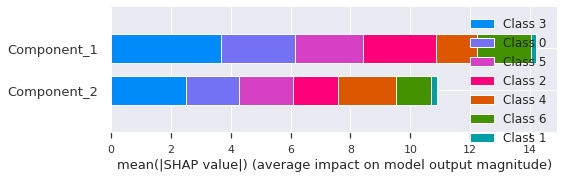

In [212]:
interpret_model(tuned_lgbm_pca, plot='summary')

In [ ]:
#explainer = shap.TreeExplainer(tuned_rf_pca)
#X = df.drop('class', axis=1)
#shap_values = explainer.shap_values(X)
#shap.summary_plot(shap_values, X)

**Visualize a single prediction**

In [213]:
interpret_model(tuned_lightgbm_pca, plot='reason', observation=40)

From the above the plot, we can seethe "base value," which is defined as the mean predicted target; and f(x), which is the prediction for a selected observation (i.e. observation number 32). The red-colored features increased the predicted value, while the blue-colored features decreased it. The size of each feature (i.e. Principal Component) indicates the impact it has on the model.

**Visualize many predictions**

In [214]:
interpret_model(tuned_lightgbm_pca, plot='reason')